In [2]:
from dask.distributed import Client, LocalCluster
cluster = LocalCluster()
client = Client(cluster)

In [3]:
import datacube
import xarray as xr
from pyproj import Proj
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from odc.ui import DcViewer
from datacube.utils import masking
from datacube.utils.rio import configure_s3_access
from dea_tools.plotting import display_map, rgb

configure_s3_access(aws_unsigned=False, requester_pays=True, client=client)
dc = datacube.Datacube(app='Uploading_data')

In [4]:
import ephem
import datetime
from datetime import datetime


def calculate_sun_elevation(latitude, longitude, date_time):
    
    date_time = datetime.strptime(date_time, '%Y-%m-%dT%H:%M:%S')
    
    # Create an observer object for the specified location
    observer = ephem.Observer()
    observer.lat = str(latitude)  # Latitude in decimal degrees
    observer.lon = str(longitude)  # Longitude in decimal degrees

    # Set the observer's date and time
    observer.date = date_time

    # Compute the position of the sun
    sun = ephem.Sun(observer)

    # Get the sun's elevation in degrees
    sun_elevation = sun.alt * 180 / ephem.pi

    return sun_elevation

In [5]:
def replace_with_nan(image, n):
    h, w = image.shape
    new_image = np.copy(image)
    for i in range(h - n + 1):
        for j in range(w - n + 1):
            # Check if all borders are NaN
            if (np.isnan(image[i, j:j+n]).all() and  # Top border
                np.isnan(image[i+n-1, j:j+n]).all() and  # Bottom border
                np.isnan(image[i:i+n, j]).all() and  # Left border
                np.isnan(image[i:i+n, j+n-1]).all()):  # Right border
                # Replace central values with NaN
                new_image[i+1:i+n-1, j+1:j+n-1] = np.nan
    return new_image

def replace_with_true(image, n):
    h, w = image.shape
    new_image = np.copy(image)
    for i in range(h - n + 1):
        for j in range(w - n + 1):
            # Check if all borders are True
            if ((image[i, j:j+n]).all() and  # Top border
                (image[i+n-1, j:j+n]).all() and  # Bottom border
                (image[i:i+n, j]).all() and  # Left border
                (image[i:i+n, j+n-1]).all()):  # Right border
                # Replace central values with True
                new_image[i+1:i+n-1, j+1:j+n-1] = True
    return new_image

In [6]:
mask_zone1 = {"y": (-51.01, -50.90), "x": (-73.18, -73.10)}
mask_zone2 = {"y": (-50.96, -50.90), "x": (-73.21, -73.10)}
mask_zone3 = {"y": (-50.90, -50.80), "x": (-73.25, -73.10)}
mask_zone4 = {"y": (-50.87, -50.80), "x": (-73.28, -73.10)}
mask_zone5 = {"y": (-51.05, -50.90), "x": (-73.40, -73.305)}
mask_zone6 = {"y": (-50.88, -50.86), "x": (-73.26, -73.10)}
mask_zone7 = {"y": (-50.905, -50.884), "x": (-73.37, -73.32)}
masks = [mask_zone1, mask_zone2, mask_zone3, mask_zone4, mask_zone5, mask_zone6, mask_zone7]
display_map(x = mask_zone6['x'], y = mask_zone6['y'])

In [7]:
query = {
    "product": "landsat8_c2l2_sr",
    "y": (-51.05, -50.825), 
    "x":  (-73.375, -73.16),
    "time": ("2000-01-01", "2023-12-31"),
    "output_crs": "EPSG:32719",
    "resolution": (-30, 30),
    "dask_chunks": {"time": 1, 'x':2048, 'y':2048},
    "group_by": "solar_day"
}

ds = dc.load(**query)

In [8]:
from datacube.utils import masking
bandas_reflectancia = ["coastal", "blue", "green", "red", "nir08", "swir16", "swir22"]
masking.describe_variable_flags(ds.qa_pixel)

# REVISAR!!!
good_pixel_flags = {
    #"snow": "not_high_confidence",
    "cloud": "not_high_confidence",
    "cirrus": "not_high_confidence",
    "cloud_shadow": "not_high_confidence",
    "nodata": False
}

In [9]:
quality_band = 'qa_pixel'
cloud_free_mask1 = masking.make_mask(ds[quality_band], **good_pixel_flags)
months = ds['time.month']
is_summer = (months <= 4) | (months >= 10)

In [10]:
valid_pixel_proportion = cloud_free_mask1.sum(dim=("x", "y"))/(cloud_free_mask1.shape[1] * cloud_free_mask1.shape[2])

elevations = []
for t in cloud_free_mask1.time.values:
    time = str(t).split('.')[0]
    lat = -51
    long = -73.2
    sun_elevation = calculate_sun_elevation(lat, long, time)
    elevations.append(sun_elevation)

elevations = np.array(elevations)
midd_day = elevations > 25

valid_threshold = 0.8

observations_to_keep = (valid_pixel_proportion >= valid_threshold) & is_summer & midd_day

In [11]:
ds_raw = ds[bandas_reflectancia].where(True)
dsf = ds_raw.where(cloud_free_mask1)
ds_clean = dsf.sel(time=observations_to_keep).persist()
ds_RAW = ds_raw.sel(time=observations_to_keep).persist()

/env/lib/python3.10/site-packages/rasterio/warp.py:344: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  _reproject(
/env/lib/python3.10/site-packages/rasterio/warp.py:344: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  _reproject(
/env/lib/python3.10/site-packages/rasterio/warp.py:344: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  _reproject(
/env/lib/python3.10/site-packages/rasterio/warp.py:344: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  _reproject(


In [12]:
print(f'Images uploaded with DataCube: {len(ds["time"])}')
print(f'Images that pass the filters: {len(ds_clean["time"])}')

Images uploaded with DataCube: 359
Images that pass the filters: 9


In [13]:
ds_RAW_norm = (ds_RAW * 0.0000275 + -0.2)
ds_RAW_norm = ds_RAW_norm#.where(ds_RAW_norm >= 0).where(ds_RAW_norm <= 1).compute()

ds_SnowID_RAW = ((ds_RAW_norm['green'] - ds_RAW_norm['swir16']) / (ds_RAW_norm['green'] + ds_RAW_norm['swir16'])).compute()
ds_SnowID_RAW.attrs = ds_RAW_norm['red'].attrs

In [14]:
ds_SnowID_RAW = ds_SnowID_RAW.where(ds_SnowID_RAW > 0.7).compute().where(ds_RAW_norm['blue'] > 0.2).compute()

/env/lib/python3.10/site-packages/distributed/client.py:3163: UserWarning: Sending large graph of size 16.38 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


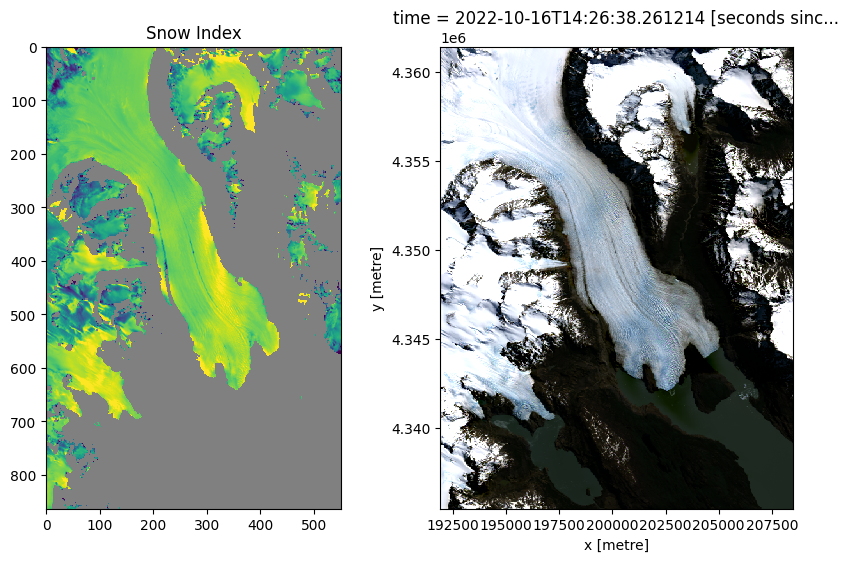

In [16]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios':[1,1], 'height_ratios':[1]})

n_img = 8

img = ds_SnowID_RAW.isel(time=n_img)
#img.plot.imshow(ax=ax[0])
ax[0].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")

RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[1])
ax[1].set_facecolor("grey")

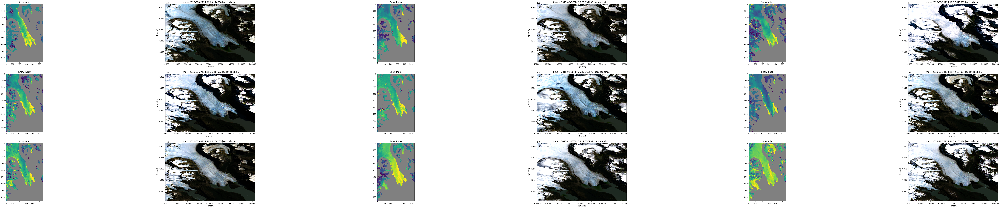

In [17]:
#Parametros del grafico
T = len(ds_SnowID_RAW['time']) # Numero de imagenes
large_img = 20                 # Tamano de la imagen
nx = 3                         # Numero de filas 
ny = T//nx                     # Numero de columnas

len_x = len(ds_SnowID_RAW['x'])
len_y = len(ds_SnowID_RAW['y'])
razon = len_y/len_x
fig, ax = plt.subplots(nx, ny*2, figsize=(np.round(large_img**(razon)), large_img), gridspec_kw={'width_ratios':[1*razon**2,1]*ny, 'height_ratios':[1]*nx})

for i in range(nx):
    for j in range(ny):
        img = ds_SnowID_RAW.isel(time=i*ny + j)
        ax[i, j*2].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
        ax[i, j*2].set_title('Snow Index')
        ax[i, j*2].set_facecolor("grey")
        ax[i, j*2].set_facecolor("grey")

        RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=i*ny+j).to_array()
        RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[i, j*2+1])
        ax[i, j*2+1].set_facecolor("grey")
        
#plt.savefig('plots/images_used_SI5_B2.png')

In [18]:
bool_Xarray = ds_SnowID_RAW >0

    "y": (-51.05, -50.80), 
    "x": (-73.40, -73.10),

In [19]:
crs = ds.crs
P = Proj(crs)

In [20]:
min_pixels = []
max_pixels = []
for m, mask in enumerate(masks):
    min_pixels.append(P(masks[m]['x'][0], masks[m]['y'][0]))
    max_pixels.append(P(masks[m]['x'][1], masks[m]['y'][1]))

In [21]:

xpix_mins = []
xpix_maxs = []
ypix_mins = []
ypix_maxs = []
for m, mask in enumerate(masks):
    xpix_mins.append(np.abs(ds_SnowID_RAW['x'].values - min_pixels[m][0]).argmin())
    xpix_maxs.append(np.abs(ds_SnowID_RAW['x'].values - max_pixels[m][0]).argmin())
    ypix_mins.append(np.abs(ds_SnowID_RAW['y'].values - min_pixels[m][1]).argmin())
    ypix_maxs.append(np.abs(ds_SnowID_RAW['y'].values - max_pixels[m][1]).argmin())

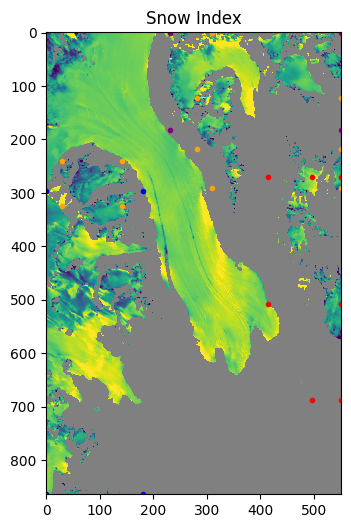

In [22]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

n_img = 8

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))

colors = ['red', 'red', 'orange', 'purple', 'blue', 'orange', 'orange']
for m, mask in enumerate(masks):
    ax.plot(xpix_mins[m], ypix_mins[m], '.', color=colors[m])
    ax.plot(xpix_mins[m], ypix_maxs[m], '.', color=colors[m])
    ax.plot(xpix_maxs[m], ypix_mins[m], '.', color=colors[m])
    ax.plot(xpix_maxs[m], ypix_maxs[m], '.', color=colors[m])
ax.set_title('Snow Index')
ax.set_facecolor("grey")
ax.set_facecolor("grey")

In [23]:
for m, mask in enumerate(masks):
    ds_SnowID_RAW.loc[dict(x=slice(min_pixels[m][0], max_pixels[m][0]), y=slice(max_pixels[m][1], min_pixels[m][1]))] = np.nan

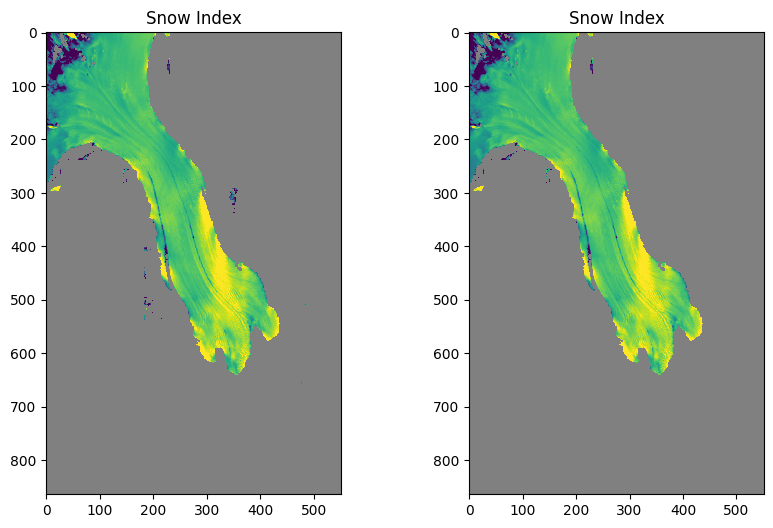

In [24]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6))

n_img = 8
img = ds_SnowID_RAW.isel(time=n_img)
filtered_image = replace_with_nan(img, 100)

ax[0].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")


ax[1].imshow(filtered_image, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[1].set_title('Snow Index')
ax[1].set_facecolor("grey")
ax[1].set_facecolor("grey")

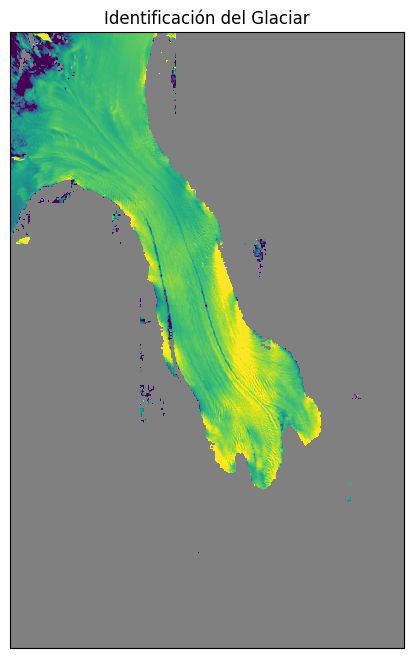

In [31]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 8

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciar.png')

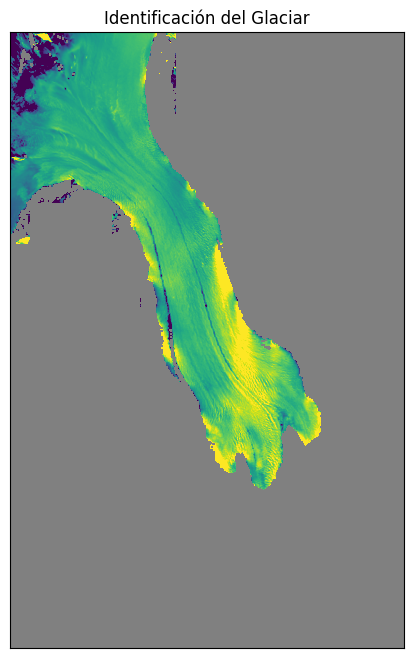

In [32]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 8

img = filtered_image
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciarFilter.png')

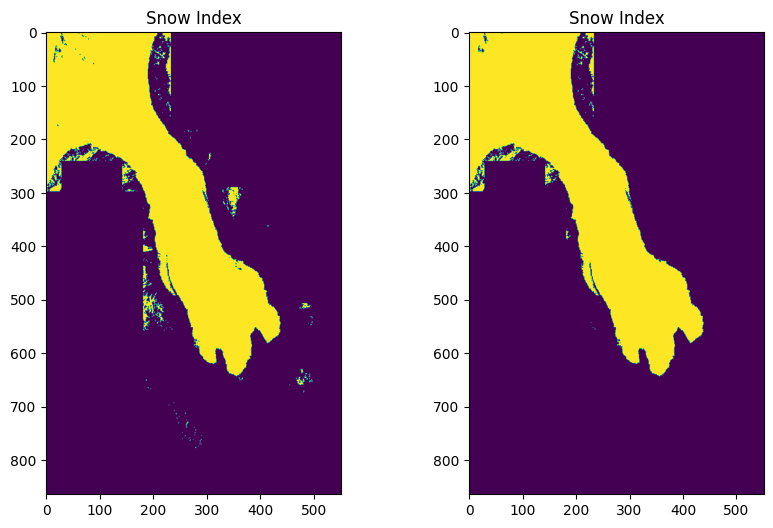

In [96]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6))

n_img = 8
img = ds_SnowID_RAW.isel(time=n_img)
bool_img_initial = img > 0
#filtered_image = replace_with_nan(img, 100)
bool_img = filtered_img > 0
#clean_image = replace_with_true(bool_img, 50)

ax[0].imshow(bool_img_initial, cmap='viridis')
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")


ax[1].imshow(clean_image, cmap='viridis')
ax[1].set_title('Snow Index')
ax[1].set_facecolor("grey")
ax[1].set_facecolor("grey")

In [97]:
Areas_L8 = []
times_L8 = []
for t in range(T):
    img = ds_SnowID_RAW.isel(time=t)
    filtered_img = replace_with_nan(img, 100)
    booled_img = filtered_img > 0
    smooth_img = replace_with_true(booled_img, 50)
    len_x = np.abs(img.x.values[-1] - img.x.values[0])
    len_y = np.abs(img.y.values[-1] - img.y.values[0])
    area = (np.sum(smooth_img) / (len(img.x)*len(img.y))) * (len_x/1000) * (len_y/1000)
    Areas_L8.append(area)
    date = img['time'].values.astype('datetime64[Y]').astype(int) + 1970 + (img['time'].values.astype('datetime64[M]').astype(int) % 12 + 1)/12
    times_L8.append(date)

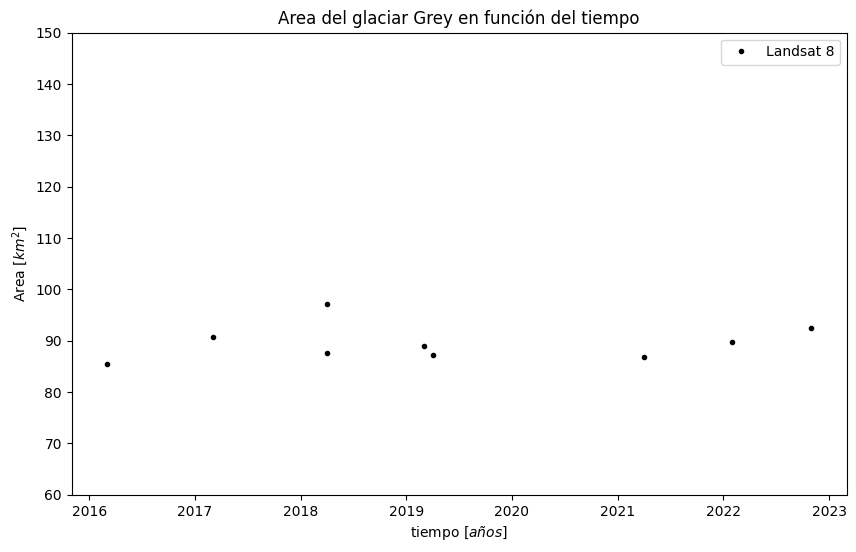

In [98]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
ax.set_title('Area del glaciar Grey en función del tiempo')
ax.set_xlabel('tiempo $[años]$')
ax.set_ylabel('Area $[km^2]$')
ax.set_ylim(2*3*10, 5*3*10)
ax.plot(times_L8, Areas_L8, '.', color='black', label='Landsat 8')
plt.legend()

In [121]:
data = {'time': times_L8, 'area': Areas_L8} 
df_L8 = pd.DataFrame(data)

df_L8.to_csv('Area_L8.csv', index=False)

# Landsat 7

In [33]:
query = {
    "product": "landsat7_c2l2_sr",
    "y": (-51.05, -50.825), 
    "x":  (-73.375, -73.16),
    "time": ("1998-01-01", "2023-12-31"),
    "output_crs": "EPSG:32719",
    "resolution": (-30, 30),
    "dask_chunks": {"time": 1, 'x':2048, 'y':2048},
    "group_by": "solar_day"
}

ds = dc.load(**query)

In [52]:
def interpolate_nan_vertical(image):
    # Get image dimensions
    time, height, width = image.shape
    # Iterate over each column
    for t in range(time):
        #print(f'Complete: {np.round(t/time*100, 1)} % ')
        for j in range(width):
            # Find indices of non-NaN values
            valid_indices = np.where(~(image[t, :, j]==-0.2))[0]
            # Interpolate NaN values vertically
            image[t, :, j] = np.interp(np.arange(height), valid_indices, image[t, valid_indices, j], left=np.nan, right=np.nan)
    return image

def interpolate_nan_verticalt(image):
    # Get image dimensions
    height, width = image.shape
    # Iterate over each column
    for j in range(width):
        # Find indices of non-NaN values
        valid_indices = np.where(~(image[:, j]==0))[0]
        # Interpolate NaN values vertically
        image[:, j] = np.interp(np.arange(height), valid_indices, image[valid_indices, j], left=np.nan, right=np.nan)
    return image

In [35]:
from datacube.utils import masking
bandas_reflectancia = ["blue", "green", "red", "nir08", "swir16", "swir22"]

# REVISAR!!!
good_pixel_flags = {
    #"snow": "not_high_confidence",
    "cloud": "not_high_confidence",
    #"cirrus": "not_high_confidence",
    #"dilated_cloud": 'not_dilated',
    "cloud_shadow": "not_high_confidence",
    "nodata": False
}

In [36]:
quality_band = 'qa_pixel'
cloud_free_mask1 = masking.make_mask(ds[quality_band], **good_pixel_flags)
months = ds['time.month']
is_summer = (months <= 4) | (months >= 10)

In [37]:
valid_pixel_proportion = cloud_free_mask1.sum(dim=("x", "y"))/(cloud_free_mask1.shape[1] * cloud_free_mask1.shape[2])

elevations = []
for t in cloud_free_mask1.time.values:
    time = str(t).split('.')[0]
    lat = -51
    long = -73.2
    sun_elevation = calculate_sun_elevation(lat, long, time)
    elevations.append(sun_elevation)

elevations = np.array(elevations)
midd_day = elevations > 25

valid_threshold = 0.8

observations_to_keep = (valid_pixel_proportion >= valid_threshold) & is_summer & midd_day

In [38]:
ds_raw = ds[bandas_reflectancia].where(True)
dsf = ds_raw.where(cloud_free_mask1)

In [39]:
ds_clean = dsf.sel(time=observations_to_keep).persist()
ds_RAW = ds_raw.sel(time=observations_to_keep).persist()

In [40]:
print(f'Images uploaded with DataCube: {len(ds["time"])}')
print(f'Images that pass the filters: {len(ds_clean["time"])}')

Images uploaded with DataCube: 716
Images that pass the filters: 15


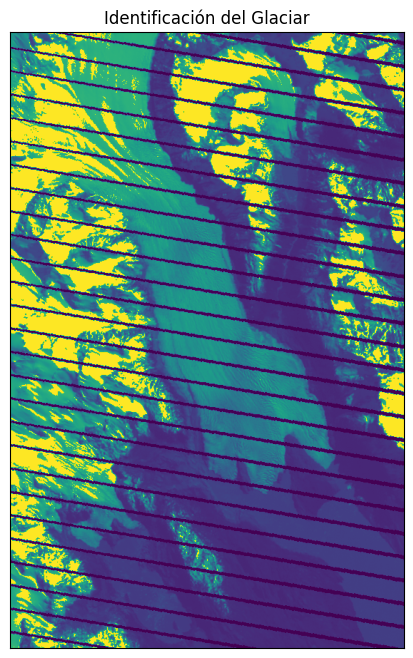

In [41]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 7

img = ds_RAW['red'].isel(time=7).values
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciarL7.png')

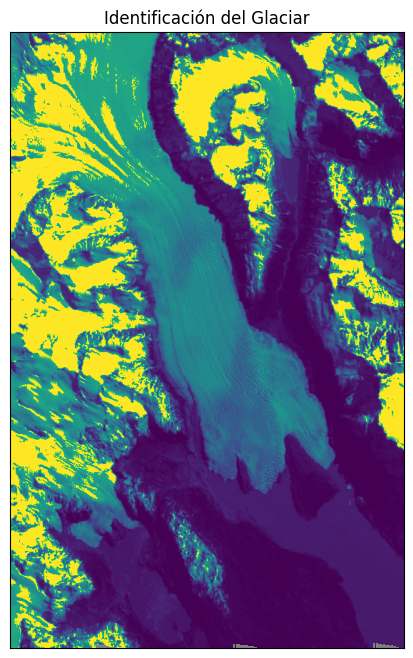

In [62]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 7

img = interpolate_nan_verticalt(ds_RAW['red'].isel(time=n_img).values)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciarL7Inter.png')

In [54]:
ds_RAW_norm = (ds_RAW * 0.0000275 + -0.2).where(True)
ds_RAW_norm = ds_RAW_norm#.where(ds_RAW_norm >= 0).where(ds_RAW_norm <= 1).compute()

In [55]:
swir16 = interpolate_nan_vertical(ds_RAW_norm['swir16'].values)

In [56]:
green = interpolate_nan_vertical(ds_RAW_norm['green'].values)

In [57]:
blue = xr.DataArray(interpolate_nan_vertical(ds_RAW_norm['blue'].values), coords={'time': ds_RAW_norm['red'].time,'y': ds_RAW_norm['red'].y,'x': ds_RAW_norm['red'].x}, dims=["time", "y", "x"])
blue.attrs = ds_RAW_norm['red'].attrs

In [58]:
ds_SnowID_RAW = xr.DataArray((green - swir16) / (green + swir16), coords={'time': ds_RAW_norm['red'].time,'y': ds_RAW_norm['red'].y,'x': ds_RAW_norm['red'].x}, dims=["time", "y", "x"])
ds_SnowID_RAW.attrs = ds_RAW_norm['red'].attrs

In [59]:
ds_SnowID_RAW = ds_SnowID_RAW.where(ds_SnowID_RAW > 0.7).compute().where(blue > 0.2).compute()

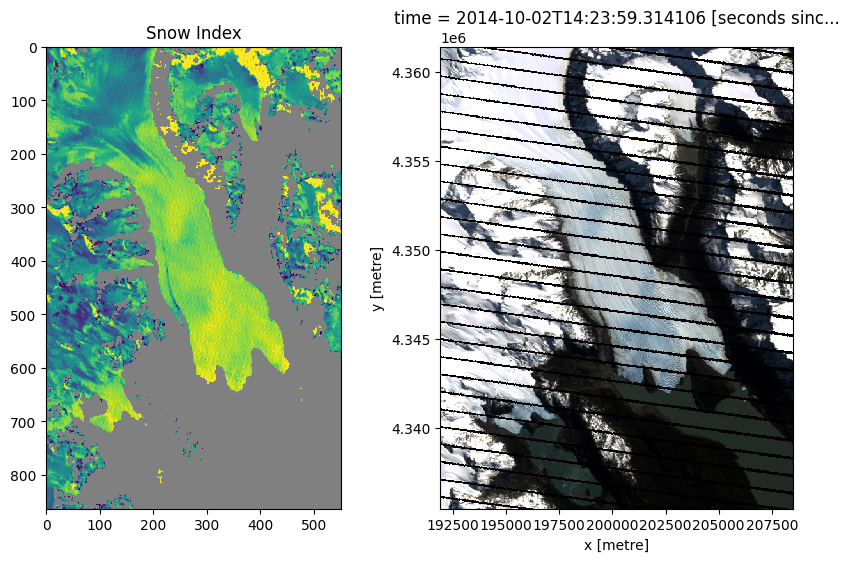

In [60]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios':[1,1], 'height_ratios':[1]})

n_img = 7

img = ds_SnowID_RAW.isel(time=n_img)
ax[0].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")

RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[1])
ax[1].set_facecolor("grey")

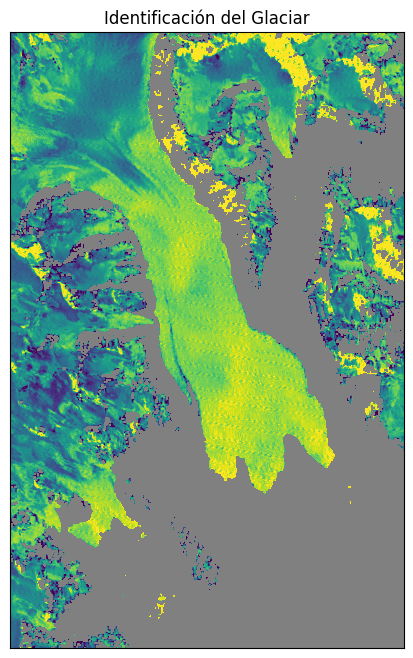

In [63]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 7

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciarL7Identify.png')

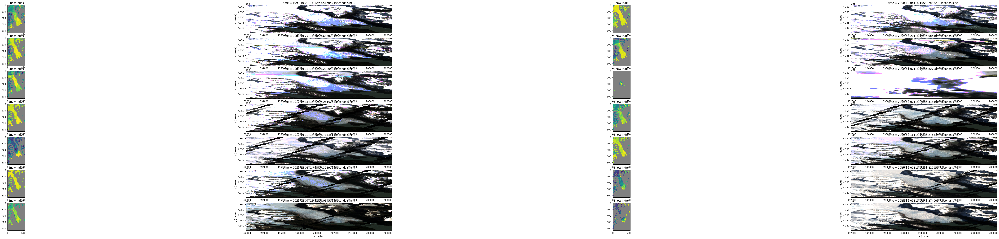

In [64]:
#Parametros del grafico
T = len(ds_SnowID_RAW['time']) # Numero de imagenes
large_img = 18                 # Tamano de la imagen
nx = 7                         # Numero de filas 
ny = T//nx                     # Numero de columnas

len_x = len(ds_SnowID_RAW['x'])
len_y = len(ds_SnowID_RAW['y'])
razon = len_y/len_x
fig, ax = plt.subplots(nx, ny*2, figsize=(np.round(large_img**(razon)), large_img), gridspec_kw={'width_ratios':[1*razon**2,1]*ny, 'height_ratios':[1]*nx})

for i in range(nx):
    for j in range(ny):
        img = ds_SnowID_RAW.isel(time=i*ny + j)
        ax[i, j*2].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
        ax[i, j*2].set_title('Snow Index')
        ax[i, j*2].set_facecolor("grey")
        ax[i, j*2].set_facecolor("grey")

        RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=i*ny+j).to_array()
        RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[i, j*2+1])
        ax[i, j*2+1].set_facecolor("grey")
        
#plt.savefig('plots/images_used_SI5_B2.png')

In [65]:
ds_clean_norm = (ds_clean * 0.0000275 + -0.2)

/env/lib/python3.10/site-packages/matplotlib/cm.py:489: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


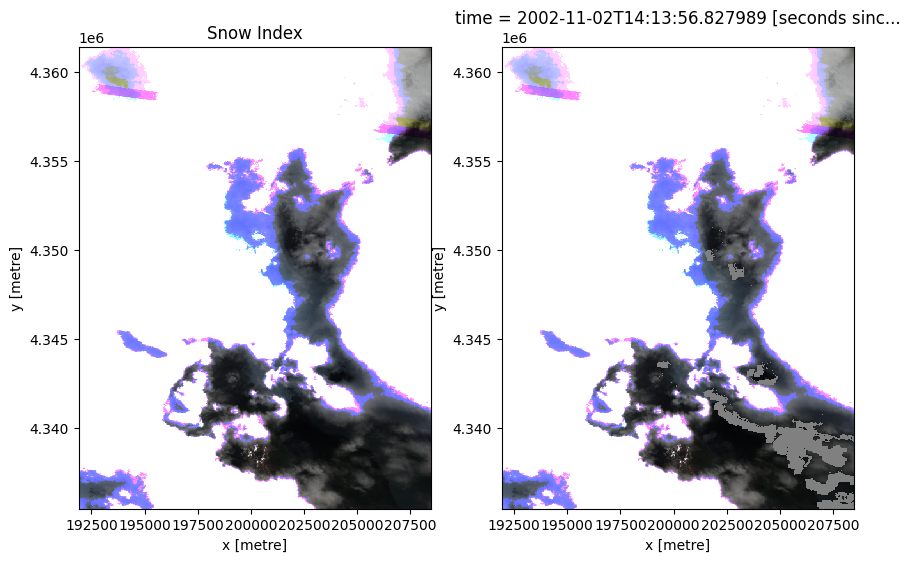

In [66]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios':[1,1], 'height_ratios':[1]})



n_img = 5

img = ds_RAW_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
img.plot.imshow(vmin=0, vmax=1, ax=ax[0])
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")

RGB_array = ds_clean_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[1])
ax[1].set_facecolor("grey")

In [67]:
bool_Xarray = ds_SnowID_RAW >0

crs = ds.crs
P = Proj(crs)

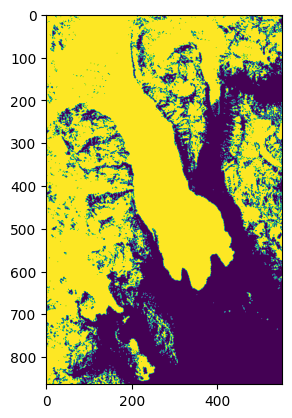

In [68]:
plt.imshow(bool_Xarray.isel(time=11))

In [69]:
min_pixels = []
max_pixels = []
for m, mask in enumerate(masks):
    min_pixels.append(P(masks[m]['x'][0], masks[m]['y'][0]))
    max_pixels.append(P(masks[m]['x'][1], masks[m]['y'][1]))
    

xpix_mins = []
xpix_maxs = []
ypix_mins = []
ypix_maxs = []
for m, mask in enumerate(masks):
    xpix_mins.append(np.abs(ds_SnowID_RAW['x'].values - min_pixels[m][0]).argmin())
    xpix_maxs.append(np.abs(ds_SnowID_RAW['x'].values - max_pixels[m][0]).argmin())
    ypix_mins.append(np.abs(ds_SnowID_RAW['y'].values - min_pixels[m][1]).argmin())
    ypix_maxs.append(np.abs(ds_SnowID_RAW['y'].values - max_pixels[m][1]).argmin())

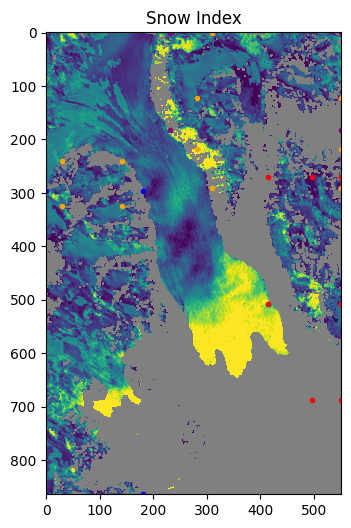

In [70]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

n_img = 8

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))

colors = ['red', 'red', 'orange', 'purple', 'blue', 'orange', 'orange']
for m, mask in enumerate(masks):
    ax.plot(xpix_mins[m], ypix_mins[m], '.', color=colors[m])
    ax.plot(xpix_mins[m], ypix_maxs[m], '.', color=colors[m])
    ax.plot(xpix_maxs[m], ypix_mins[m], '.', color=colors[m])
    ax.plot(xpix_maxs[m], ypix_maxs[m], '.', color=colors[m])
ax.set_title('Snow Index')
ax.set_facecolor("grey")
ax.set_facecolor("grey")

In [71]:
for m, mask in enumerate(masks):
    ds_SnowID_RAW.loc[dict(x=slice(int(min_pixels[m][0]), int(max_pixels[m][0])), y=slice(int(max_pixels[m][1]), int(min_pixels[m][1])))] = np.nan

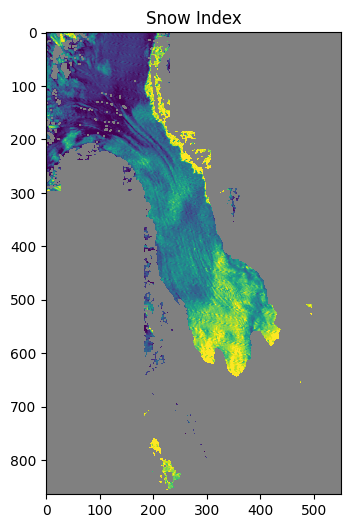

In [168]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

n_img = 11

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax.set_title('Snow Index')
ax.set_facecolor("grey")
ax.set_facecolor("grey")

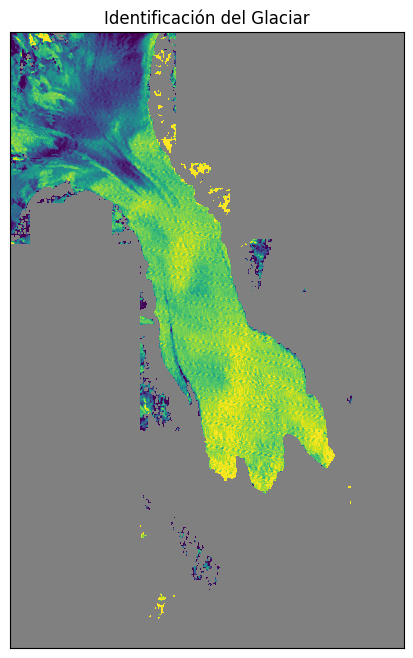

In [72]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 7

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciarL7Masked.png')

In [74]:
filtered_image = replace_with_nan(img, 100)

In [77]:
filtered_img = replace_with_nan(filtered_image, 200)

In [81]:
filtered_img2 = replace_with_nan(filtered_img, 50)

In [83]:
filtered_img3 = replace_with_nan(filtered_img2, 100)

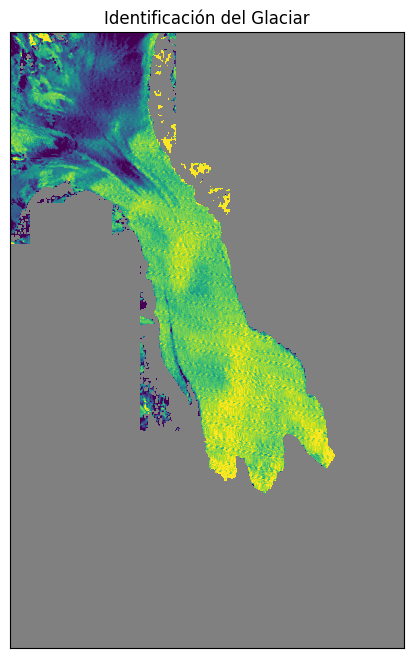

In [84]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

n_img = 7

img = filtered_img3
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))


ax.set_title('Identificación del Glaciar')
ax.set_facecolor("grey")
ax.set_facecolor("grey")
plt.tick_params(left = False, right = False , labelleft = False , 
                labelbottom = False, bottom = False) 

plt.savefig('IdentificacionGlaciarL7clean.png')

In [169]:
Areas_L7 = []
times_L7 = []
for t in range(T):
    img = ds_SnowID_RAW.isel(time=t)
    filtered_img = replace_with_nan(img, 100)
    booled_img = filtered_img > 0
    smooth_img = replace_with_true(booled_img, 50)
    len_x = np.abs(img.x.values[-1] - img.x.values[0])
    len_y = np.abs(img.y.values[-1] - img.y.values[0])
    area = (np.sum(smooth_img) / (len(img.x)*len(img.y))) * (len_x/1000) * (len_y/1000)
    Areas_L7.append(area)
    date = img['time'].values.astype('datetime64[Y]').astype(int) + 1970 + (img['time'].values.astype('datetime64[M]').astype(int) % 12 + 1)/12
    times_L7.append(date)

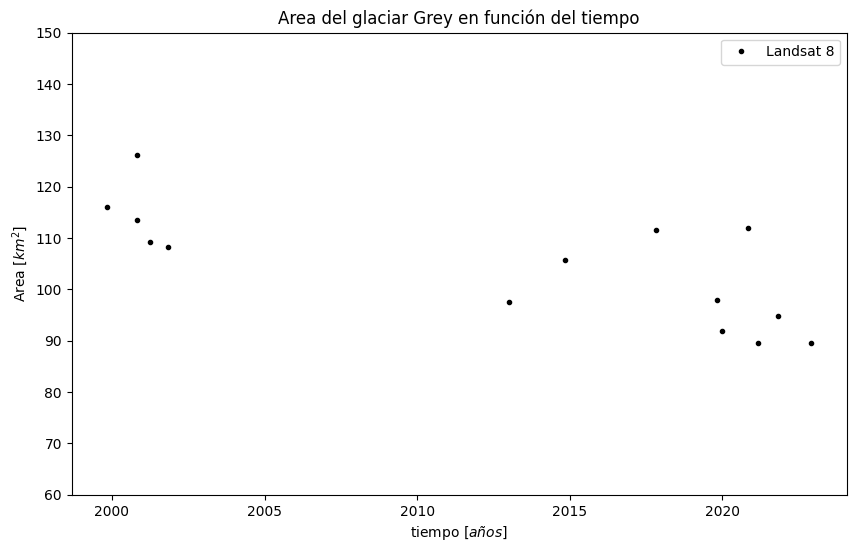

In [170]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
ax.set_title('Area del glaciar Grey en función del tiempo')
ax.set_xlabel('tiempo $[años]$')
ax.set_ylabel('Area $[km^2]$')
ax.set_ylim(2*3*10, 5*3*10)
ax.plot(times_L7, Areas_L7, '.', color='black', label='Landsat 8')
plt.legend()

In [171]:
data = {'time': times_L7, 'area': Areas_L7} 
df_L7 = pd.DataFrame(data)

df_L7.to_csv('Area_L7.csv', index=False)

# Landsat 9

In [46]:
query = {
    "product": "landsat9_c2l2_sr",
    "y": (-51.05, -50.825), 
    "x":  (-73.375, -73.16),
    "time": ("1998-01-01", "2024-03-31"),
    "output_crs": "EPSG:32719",
    "resolution": (-30, 30),
    "dask_chunks": {"time": 1, 'x':2048, 'y':2048},
    "group_by": "solar_day"
}

ds = dc.load(**query)

In [47]:
from datacube.utils import masking
bandas_reflectancia = ["coastal", "blue", "green", "red", "nir08", "swir16", "swir22"]
masking.describe_variable_flags(ds.qa_pixel)

# REVISAR!!!
good_pixel_flags = {
    #"snow": "not_high_confidence",
    "cloud": "not_high_confidence",
    "cirrus": "not_high_confidence",
    "cloud_shadow": "not_high_confidence",
    "nodata": False
}

In [48]:
quality_band = 'qa_pixel'
cloud_free_mask1 = masking.make_mask(ds[quality_band], **good_pixel_flags)
months = ds['time.month']
is_summer = (months <= 4) | (months >= 10)

In [49]:
valid_pixel_proportion = cloud_free_mask1.sum(dim=("x", "y"))/(cloud_free_mask1.shape[1] * cloud_free_mask1.shape[2])

elevations = []
for t in cloud_free_mask1.time.values:
    time = str(t).split('.')[0]
    lat = -51
    long = -73.2
    sun_elevation = calculate_sun_elevation(lat, long, time)
    elevations.append(sun_elevation)

elevations = np.array(elevations)
midd_day = elevations > 25

valid_threshold = 0.8

observations_to_keep = (valid_pixel_proportion >= valid_threshold) & is_summer & midd_day

In [50]:
ds_raw = ds[bandas_reflectancia].where(True)
dsf = ds_raw.where(cloud_free_mask1)
ds_clean = dsf.sel(time=observations_to_keep).persist()
ds_RAW = ds_raw.sel(time=observations_to_keep).persist()

print(f'Images uploaded with DataCube: {len(ds["time"])}')
print(f'Images that pass the filters: {len(ds_clean["time"])}')

Images uploaded with DataCube: 85
Images that pass the filters: 0


In [51]:
ds_RAW_norm = (ds_RAW * 0.0000275 + -0.2)
ds_RAW_norm = ds_RAW_norm#.where(ds_RAW_norm >= 0).where(ds_RAW_norm <= 1).compute()

ds_SnowID_RAW = ((ds_RAW_norm['green'] - ds_RAW_norm['swir22']) / (ds_RAW_norm['green'] + ds_RAW_norm['swir22'])).compute()
ds_SnowID_RAW.attrs = ds_RAW_norm['red'].attrs

In [52]:
ds_SnowID_RAW = ds_SnowID_RAW.where(ds_SnowID_RAW > 0.7).compute().where(ds_RAW_norm['blue'] > 0.2).compute()

IndexError: index 0 is out of bounds for axis 0 with size 0

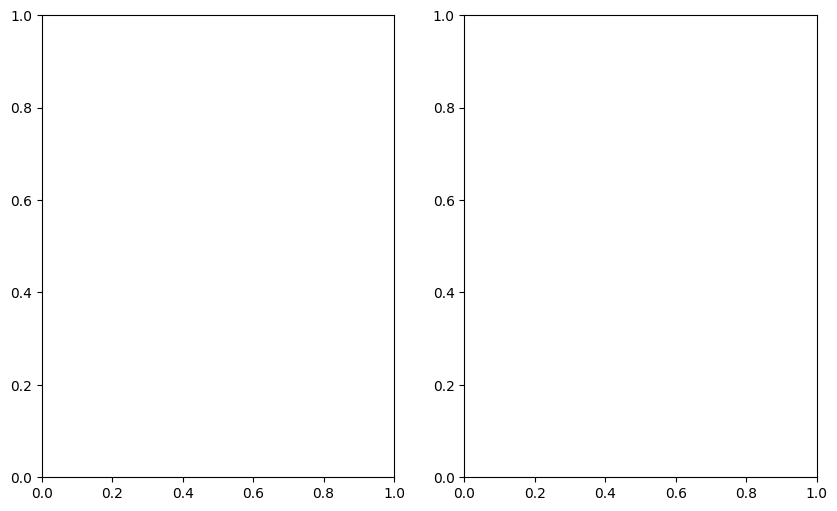

In [53]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios':[1,1], 'height_ratios':[1]})

n_img = 0

img = ds_SnowID_RAW.isel(time=n_img)
ax[0].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")

RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[1])
ax[1].set_facecolor("grey")

In [ ]:
bool_Xarray = ds_SnowID_RAW >0

crs = ds.crs
P = Proj(crs)

In [ ]:
min_pixels = []
max_pixels = []
for m, mask in enumerate(masks):
    min_pixels.append(P(masks[m]['x'][0], masks[m]['y'][0]))
    max_pixels.append(P(masks[m]['x'][1], masks[m]['y'][1]))
    

xpix_mins = []
xpix_maxs = []
ypix_mins = []
ypix_maxs = []
for m, mask in enumerate(masks):
    xpix_mins.append(np.abs(ds_SnowID_RAW['x'].values - min_pixels[m][0]).argmin())
    xpix_maxs.append(np.abs(ds_SnowID_RAW['x'].values - max_pixels[m][0]).argmin())
    ypix_mins.append(np.abs(ds_SnowID_RAW['y'].values - min_pixels[m][1]).argmin())
    ypix_maxs.append(np.abs(ds_SnowID_RAW['y'].values - max_pixels[m][1]).argmin())

In [ ]:
for m, mask in enumerate(masks):
    ds_SnowID_RAW.loc[dict(x=slice(min_pixels[m][0], max_pixels[m][0]), y=slice(max_pixels[m][1], min_pixels[m][1]))] = np.nan

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

n_img = 0

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax.set_title('Snow Index')
ax.set_facecolor("grey")
ax.set_facecolor("grey")

In [54]:
Areas_L9 = []
times_L9 = []
for t in range(T):
    img = ds_SnowID_RAW.isel(time=t)
    len_x = np.abs(img.x.values[-1] - img.x.values[0])
    len_y = np.abs(img.y.values[-1] - img.y.values[0])
    area = (np.sum(img > 0).values / (len(img.x)*len(img.y))) * (len_x/1000) * (len_y/1000)
    Areas_L9.append(area)
    date = img['time'].values.astype('datetime64[Y]').astype(int) + 1970
    times_L9.append(date)

# Landsat 5

In [172]:
query = {
    "product": "landsat5_c2l2_sr",
    "y": (-51.05, -50.825), 
    "x":  (-73.375, -73.16),
    "time": ("1980-01-01", "2024-03-31"),
    "output_crs": "EPSG:32719",
    "resolution": (-30, 30),
    "dask_chunks": {"time": 1, 'x':2048, 'y':2048},
    "group_by": "solar_day"
}

ds = dc.load(**query)

In [173]:
from datacube.utils import masking
bandas_reflectancia = ["blue", "green", "red", "nir08", "swir16", "swir22"]
masking.describe_variable_flags(ds.qa_pixel)

# REVISAR!!!
good_pixel_flags = {
    #"snow": "not_high_confidence",
    "cloud": "not_high_confidence",
    #"cirrus": "not_high_confidence",
    "cloud_shadow": "not_high_confidence",
    "nodata": False
}

In [174]:
quality_band = 'qa_pixel'
cloud_free_mask1 = masking.make_mask(ds[quality_band], **good_pixel_flags)
months = ds['time.month']
is_summer = (months <= 4) | (months >= 10)

In [175]:
valid_pixel_proportion = cloud_free_mask1.sum(dim=("x", "y"))/(cloud_free_mask1.shape[1] * cloud_free_mask1.shape[2])

elevations = []
for t in cloud_free_mask1.time.values:
    time = str(t).split('.')[0]
    lat = -51
    long = -73.2
    sun_elevation = calculate_sun_elevation(lat, long, time)
    elevations.append(sun_elevation)

elevations = np.array(elevations)
midd_day = elevations > 25

valid_threshold = 0.8

observations_to_keep = (valid_pixel_proportion >= valid_threshold) & is_summer & midd_day

In [176]:
ds_raw = ds[bandas_reflectancia].where(True)
dsf = ds_raw.where(cloud_free_mask1)
ds_clean = dsf.sel(time=observations_to_keep).persist()
ds_RAW = ds_raw.sel(time=observations_to_keep).persist()

print(f'Images uploaded with DataCube: {len(ds["time"])}')
print(f'Images that pass the filters: {len(ds_clean["time"])}')

Images uploaded with DataCube: 219
Images that pass the filters: 7


In [177]:
ds_RAW_norm = (ds_RAW * 0.0000275 + -0.2)
ds_RAW_norm = ds_RAW_norm#.where(ds_RAW_norm >= 0).where(ds_RAW_norm <= 1).compute()

ds_SnowID_RAW = ((ds_RAW_norm['green'] - ds_RAW_norm['swir22']) / (ds_RAW_norm['green'] + ds_RAW_norm['swir22'])).compute()
ds_SnowID_RAW.attrs = ds_RAW_norm['red'].attrs

In [178]:
ds_SnowID_RAW = ds_SnowID_RAW.where(ds_SnowID_RAW > 0.7).compute().where(ds_RAW_norm['blue'] > 0.2).compute()

/env/lib/python3.10/site-packages/distributed/client.py:3163: UserWarning: Sending large graph of size 12.74 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


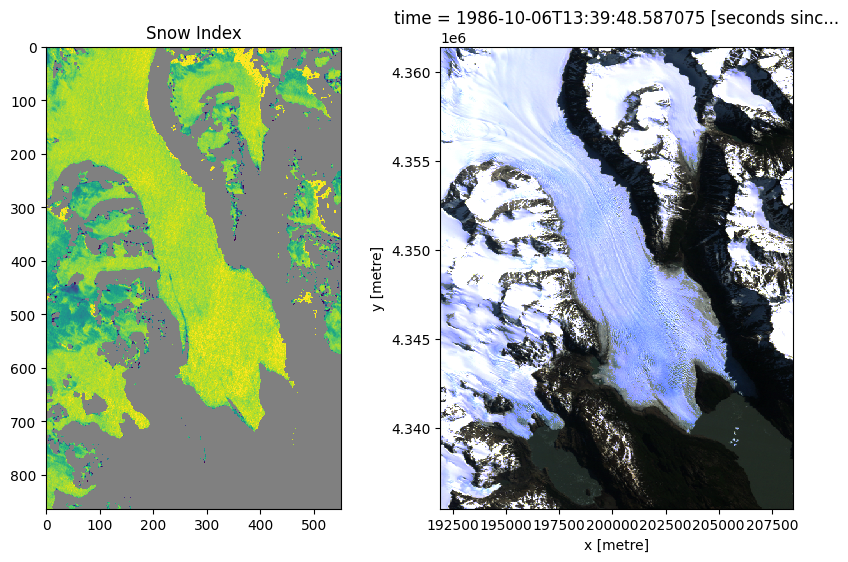

In [179]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios':[1,1], 'height_ratios':[1]})

n_img = 0

img = ds_SnowID_RAW.isel(time=n_img)
ax[0].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")

RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[1])
ax[1].set_facecolor("grey")

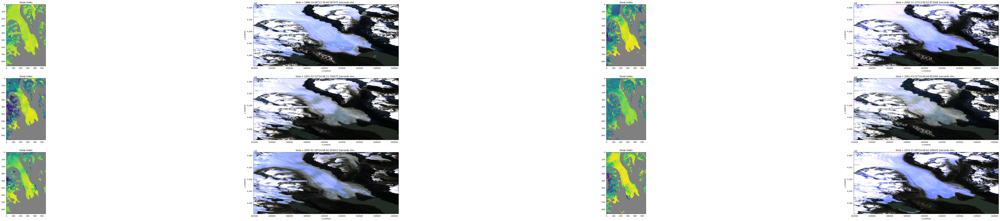

In [180]:
#Parametros del grafico
T = len(ds_SnowID_RAW['time']) # Numero de imagenes
large_img = 20                 # Tamano de la imagen
nx = 3                         # Numero de filas 
ny = T//nx                     # Numero de columnas

len_x = len(ds_SnowID_RAW['x'])
len_y = len(ds_SnowID_RAW['y'])
razon = len_y/len_x
fig, ax = plt.subplots(nx, ny*2, figsize=(np.round(large_img**(razon)), large_img), gridspec_kw={'width_ratios':[1*razon**2,1]*ny, 'height_ratios':[1]*nx})

for i in range(nx):
    for j in range(ny):
        img = ds_SnowID_RAW.isel(time=i*ny + j)
        ax[i, j*2].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
        ax[i, j*2].set_title('Snow Index')
        ax[i, j*2].set_facecolor("grey")
        ax[i, j*2].set_facecolor("grey")

        RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=i*ny+j).to_array()
        RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[i, j*2+1])
        ax[i, j*2+1].set_facecolor("grey")
        
#plt.savefig('plots/images_used_SI5_B2.png')

In [181]:
bool_Xarray = ds_SnowID_RAW >0

crs = ds.crs
P = Proj(crs)

In [182]:
min_pixels = []
max_pixels = []
for m, mask in enumerate(masks):
    min_pixels.append(P(masks[m]['x'][0], masks[m]['y'][0]))
    max_pixels.append(P(masks[m]['x'][1], masks[m]['y'][1]))
    

xpix_mins = []
xpix_maxs = []
ypix_mins = []
ypix_maxs = []
for m, mask in enumerate(masks):
    xpix_mins.append(np.abs(ds_SnowID_RAW['x'].values - min_pixels[m][0]).argmin())
    xpix_maxs.append(np.abs(ds_SnowID_RAW['x'].values - max_pixels[m][0]).argmin())
    ypix_mins.append(np.abs(ds_SnowID_RAW['y'].values - min_pixels[m][1]).argmin())
    ypix_maxs.append(np.abs(ds_SnowID_RAW['y'].values - max_pixels[m][1]).argmin())

In [183]:
for m, mask in enumerate(masks):
    ds_SnowID_RAW.loc[dict(x=slice(min_pixels[m][0], max_pixels[m][0]), y=slice(max_pixels[m][1], min_pixels[m][1]))] = np.nan

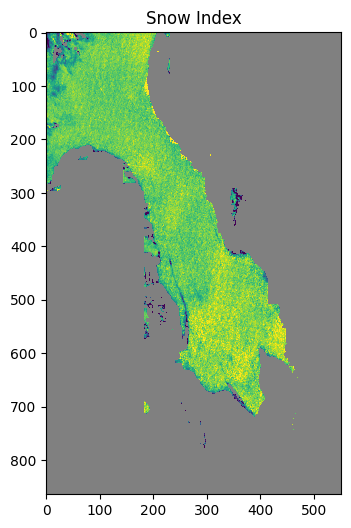

In [184]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

n_img = 0

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax.set_title('Snow Index')
ax.set_facecolor("grey")
ax.set_facecolor("grey")

In [185]:
Areas_L5 = []
times_L5 = []
for t in range(T):
    img = ds_SnowID_RAW.isel(time=t)
    filtered_img = replace_with_nan(img, 100)
    booled_img = filtered_img > 0
    smooth_img = replace_with_true(booled_img, 50)
    len_x = np.abs(img.x.values[-1] - img.x.values[0])
    len_y = np.abs(img.y.values[-1] - img.y.values[0])
    area = (np.sum(smooth_img) / (len(img.x)*len(img.y))) * (len_x/1000) * (len_y/1000)
    Areas_L5.append(area)
    date = img['time'].values.astype('datetime64[Y]').astype(int) + 1970 + (img['time'].values.astype('datetime64[M]').astype(int) % 12 + 1)/12
    times_L5.append(date)

In [188]:
data = {'time': times_L5, 'area': Areas_L5} 
df_L5 = pd.DataFrame(data)

df_L5.to_csv('Area_L5.csv', index=False)

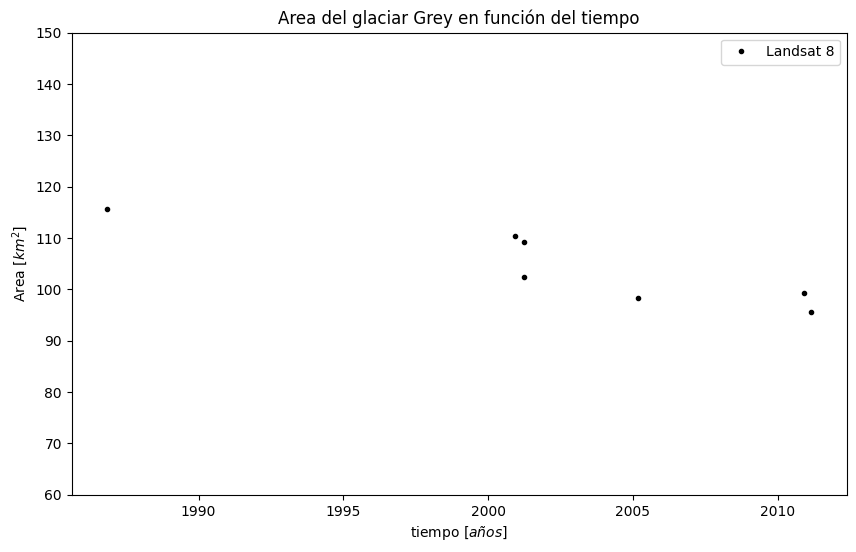

In [187]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
ax.set_title('Area del glaciar Grey en función del tiempo')
ax.set_xlabel('tiempo $[años]$')
ax.set_ylabel('Area $[km^2]$')
ax.set_ylim(2*3*10, 5*3*10)
ax.plot(times_L5, Areas_L5, '.', color='black', label='Landsat 8')
plt.legend()

# Sentinel 2

In [73]:
query = {
    "product": "s2_l2a",
    "y": (-51.05, -50.825), 
    "x":  (-73.375, -73.16),
    "time": ("1980-01-01", "2024-03-31"),
    "output_crs": "EPSG:32719",
    "resolution": (-30, 30),
    "dask_chunks": {"time": 1, 'x':2048, 'y':2048},
    "group_by": "solar_day"
}

ds = dc.load(**query)

In [74]:
bandas_reflectancia = ["coastal", "blue", "green", "red", "nir08", "swir16", "swir22"]

cloud_free_mask = (
    masking.make_mask(ds.scl, qa="no data") | 
    masking.make_mask(ds.scl, qa="cloud shadows") | 
    masking.make_mask(ds.scl, qa="cloud high probability") |
    masking.make_mask(ds.scl, qa="thin cirrus") |
    masking.make_mask(ds.scl, qa='cloud medium probability') |
    masking.make_mask(ds.scl, qa='saturated or defective')
)

In [75]:
months = ds['time.month']
is_summer = (months <= 4) | (months >= 10)

In [77]:
valid_pixel_proportion = 1 - cloud_free_mask.sum(dim=("x", "y"))/(cloud_free_mask.shape[1] * cloud_free_mask.shape[2])

elevations = []
for t in cloud_free_mask.time.values:
    time = str(t).split('.')[0]
    lat = -51
    long = -73.2
    sun_elevation = calculate_sun_elevation(lat, long, time)
    elevations.append(sun_elevation)

elevations = np.array(elevations)
midd_day = elevations > 25

valid_threshold = 0.8

observations_to_keep = (valid_pixel_proportion >= valid_threshold) & is_summer & midd_day

In [78]:
dsf = xr.where(cloud_free_mask, np.nan, ds[bandas_reflectancia])
ds_raw = ds[bandas_reflectancia].where(True)
ds_clean = dsf.sel(time=observations_to_keep).persist()
ds_RAW = ds_raw.sel(time=observations_to_keep).persist()

print(f'Images uploaded with DataCube: {len(ds["time"])}')
print(f'Images that pass the filters: {len(ds_clean["time"])}')

/env/lib/python3.10/site-packages/distributed/client.py:3163: UserWarning: Sending large graph of size 14.16 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
2024-04-04 17:58:31,190 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-04 17:58:31,604 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-04 17:58:34,631 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-04 17:58:35,032 - distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
2024-04-04 17:58:35,465 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-04-04 17:58:39,252 - distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
2

Images uploaded with DataCube: 889
Images that pass the filters: 56


2024-04-04 17:58:54,009 - distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)


<xarray.DataArray 'time' ()>
array('2018-03-07T14:36:40.689000000', dtype='datetime64[ns]')
Coordinates:
    time         datetime64[ns] 2018-03-07T14:36:40.689000
    spatial_ref  int32 32719
Attributes:
    units:    seconds since 1970-01-01 00:00:00


/env/lib/python3.10/site-packages/matplotlib/cm.py:489: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


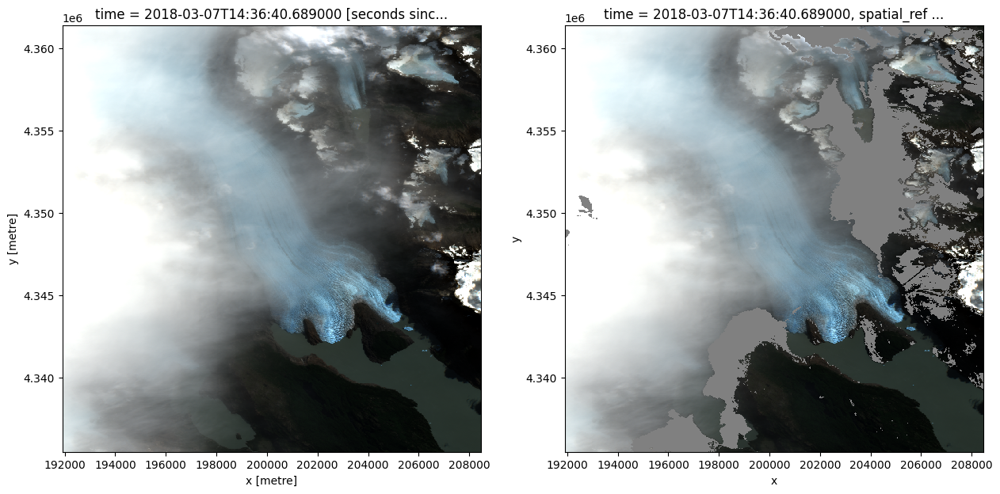

In [79]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
n_img = 8
img = ds_RAW[["red", "green", "blue"]].isel(time=n_img).squeeze().to_array()
img.plot.imshow(vmin=0, vmax=np.percentile(img, 90), robust=True, ax = ax[0])
ds_clean[["red", "green", "blue"]].isel(time=n_img).squeeze().to_array().plot.imshow(vmin=0, vmax=np.percentile(img, 90), robust=True, ax = ax[1])
ax[1].set_facecolor("grey")
print(img['time'])

In [80]:
ds_RAW_norm = (ds_RAW * 0.0001)
ds_RAW_norm = ds_RAW_norm#.where(ds_RAW_norm >= 0).where(ds_RAW_norm <= 1).compute()

ds_SnowID_RAW = ((ds_RAW_norm['green'] - ds_RAW_norm['swir22']) / (ds_RAW_norm['green'] + ds_RAW_norm['swir22'])).compute()
ds_SnowID_RAW.attrs = ds_RAW_norm['red'].attrs

2024-04-04 17:58:59,711 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


In [81]:
ds_SnowID_RAW = ds_SnowID_RAW.where(ds_SnowID_RAW > 0.7).compute().where(ds_RAW_norm['blue'] > 0.2).compute()

/env/lib/python3.10/site-packages/distributed/client.py:3163: UserWarning: Sending large graph of size 101.90 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


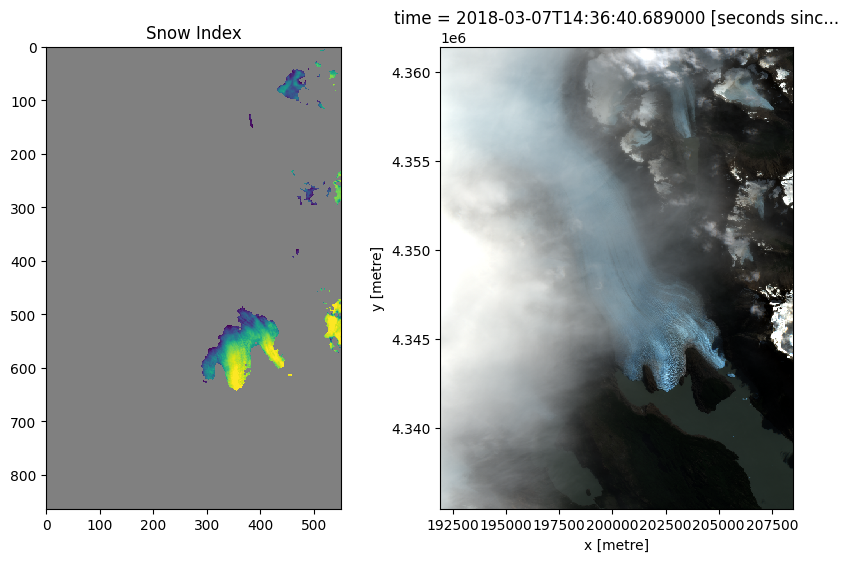

In [82]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios':[1,1], 'height_ratios':[1]})

n_img = 8

img = ds_SnowID_RAW.isel(time=n_img)
ax[0].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax[0].set_title('Snow Index')
ax[0].set_facecolor("grey")
ax[0].set_facecolor("grey")

RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=n_img).to_array()
RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[1])
ax[1].set_facecolor("grey")

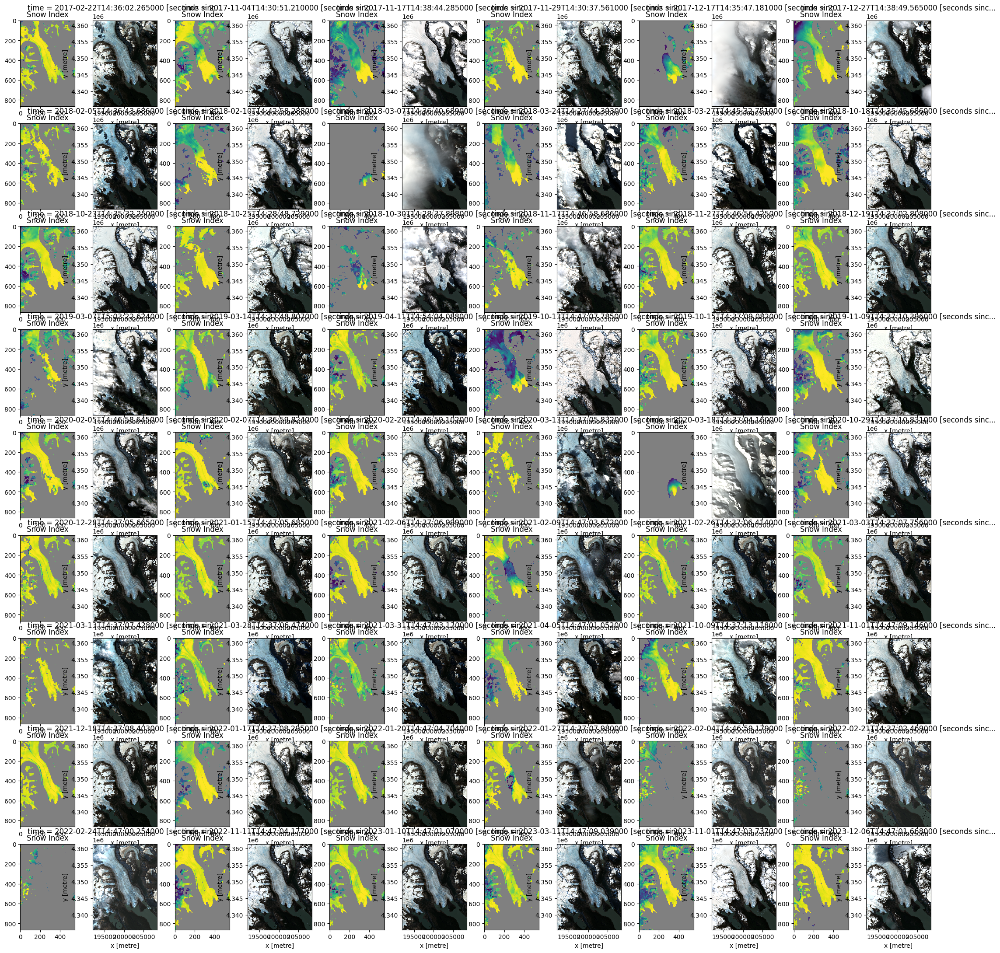

In [83]:
#Parametros del grafico
T = len(ds_SnowID_RAW['time']) # Numero de imagenes
nx = 9                         # Numero de filas 
large_img = nx*3               # Tamano de la imagen
ny = T//nx                     # Numero de columnas

len_x = len(ds_SnowID_RAW['x'])
len_y = len(ds_SnowID_RAW['y'])
razon = len_y/len_x
fig, ax = plt.subplots(nx, ny*2, figsize=(np.round(large_img), large_img), gridspec_kw={'width_ratios':[1,1]*ny, 'height_ratios':[1]*nx})

for i in range(nx):
    for j in range(ny):
        img = ds_SnowID_RAW.isel(time=i*ny + j)
        ax[i, j*2].imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
        ax[i, j*2].set_title('Snow Index')
        ax[i, j*2].set_facecolor("grey")
        ax[i, j*2].set_facecolor("grey")

        RGB_array = ds_RAW_norm[["red", "green", "blue"]].isel(time=i*ny+j).to_array()
        RGB_array.plot.imshow(vmin=0, vmax=1, ax=ax[i, j*2+1])
        ax[i, j*2+1].set_facecolor("grey")
        
#plt.savefig('plots/images_used_SI5_B2.png')

In [84]:
bool_Xarray = ds_SnowID_RAW >0

crs = ds.crs
P = Proj(crs)

In [85]:
min_pixels = []
max_pixels = []
for m, mask in enumerate(masks):
    min_pixels.append(P(masks[m]['x'][0], masks[m]['y'][0]))
    max_pixels.append(P(masks[m]['x'][1], masks[m]['y'][1]))
    

xpix_mins = []
xpix_maxs = []
ypix_mins = []
ypix_maxs = []
for m, mask in enumerate(masks):
    xpix_mins.append(np.abs(ds_SnowID_RAW['x'].values - min_pixels[m][0]).argmin())
    xpix_maxs.append(np.abs(ds_SnowID_RAW['x'].values - max_pixels[m][0]).argmin())
    ypix_mins.append(np.abs(ds_SnowID_RAW['y'].values - min_pixels[m][1]).argmin())
    ypix_maxs.append(np.abs(ds_SnowID_RAW['y'].values - max_pixels[m][1]).argmin())

In [86]:
for m, mask in enumerate(masks):
    ds_SnowID_RAW.loc[dict(x=slice(min_pixels[m][0], max_pixels[m][0]), y=slice(max_pixels[m][1], min_pixels[m][1]))] = np.nan

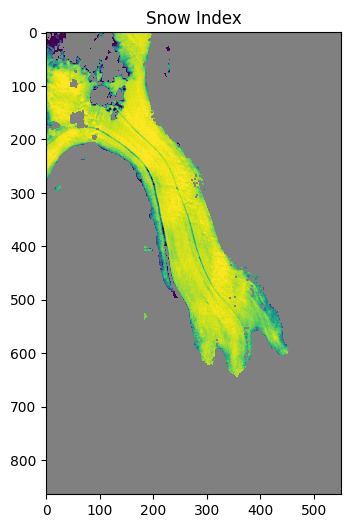

In [87]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

n_img = 0

img = ds_SnowID_RAW.isel(time=n_img)
ax.imshow(img, cmap='viridis', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
ax.set_title('Snow Index')
ax.set_facecolor("grey")
ax.set_facecolor("grey")

In [88]:
Areas_S2 = []
times_S2 = []
for t in range(T):
    img = ds_SnowID_RAW.isel(time=t)
    len_x = np.abs(img.x.values[-1] - img.x.values[0])
    len_y = np.abs(img.y.values[-1] - img.y.values[0])
    area = (np.sum(img > 0).values / (len(img.x)*len(img.y))) * (len_x/1000) * (len_y/1000)
    Areas_S2.append(area)
    date = img['time'].values.astype('datetime64[Y]').astype(int) + 1970
    times_S2.append(date)

# Plot Area

NameError: name 'times_L7' is not defined

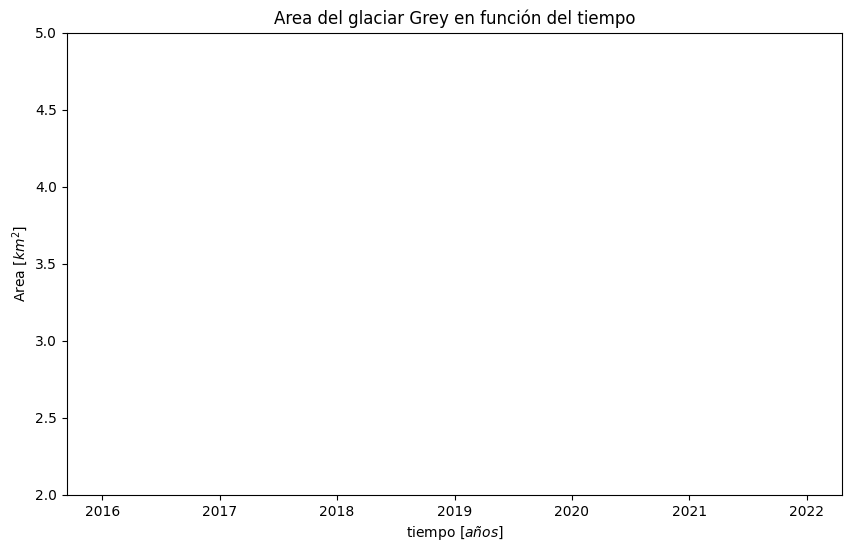

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
ax.set_title('Area del glaciar Grey en función del tiempo')
ax.set_xlabel('tiempo $[años]$')
ax.set_ylabel('Area $[km^2]$')
ax.set_ylim(2, 5)
ax.plot(times_L8, Areas_L8, '.', color='black', label='Landsat 8')
ax.plot(times_L7, Areas_L7, '+', color='black', label='Landsat 7')
ax.plot(times_L9, Areas_L9, '.', color='black', label='Landsat 9')
ax.plot(times_L5, Areas_L5, '^', color='black', label='Landsat 5')
#ax.plot(times_S2, Areas_S2, '.', color='red', label='Sentinel 2')
plt.legend()